**Exploring Metabolic Capacities of Gut Microbiota: Clustering and Representative Organisms Analysis**
<p align="justify">
This notebook examines the metabolic capacities of 100 AGORA genome-scale metabolic models (GSMMs) of gut bacteria. Dimensionality reduction techniques are applied to capture and visualize the metabolic diversity among the models, followed by clustering to group organisms with similar metabolic profiles. Representative organisms are selected from each cluster, offering insights into the metabolic roles and relationships within the gut microbiome. </p>

In [6]:
# Installing necessary packages and importing libraries
!pip install cobra
!pip install matplotlib
!pip install adjustText
!pip install fastcluster
import os
import cobra
from cobra.io import read_sbml_model
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import random
from scipy.spatial.distance import cdist

**Importing 100 AGORA models at random**

In [7]:
# Creating a function to import 100 models at random
def import_models(file_path,model_count, extension='.xml', seed=42):
      """
      Imports a specified number of model files with a given extension from a directory.

      Parameters:
      file_path (str): Path to the directory containing model files.
      model_count (int): Number of models to randomly sample.
      extension (str): File extension of the models (default: '.xml').
      seed (int): Random seed for reproducibility (default: 42).

      Returns:
      dict: A dictionary where keys are file names (without extensions) and values are full file paths.
      If there are fewer files than requested, returns a list of all available files.
      """
      random.seed(seed) # Set the random seed for reproducibility
      all_files = [file for file in os.listdir(file_path) if file.endswith(extension)]
      models={}
      if len(all_files) < model_count:
          return all_files  # Return all files if there are fewer than requested
      else:
          files = random.sample(all_files, model_count)
          for x in files:
              split_name = x.split('.')
              file_name = split_name[0]
              models[file_name] = file_path + x

      return models

In [8]:
# Mounting the drive with the AGORA models
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [9]:
# Specifying the file path and the number of models required
file_path = '/content/drive/My Drive/AGORA/CurrentVersion/AGORA_1_03/AGORA_1_03_sbml/'
model_count = 100
models = import_models(file_path,model_count)

**Extracting Exchange Reactions**

<p align="justify">This step focuses on isolating the exchange reactions from all organisms' metabolic models. Exchange reactions directly represent metabolites taken up or secreted by the organism, which are critical for understanding interactions with the environment and potential cross-feeding relationships giving insights into the organism's functional role, such as nutrient dependencies or contributions to the community.</p>

In [10]:
def get_exchange_reactions(models):
  """
  Extracts exchange reactions and their fluxes for a set of genome-scale metabolic models.

    Parameters:
    models (dict): Dictionary where keys are model names and values are paths to SBML files.

    Returns:
    tuple: (model_name, exchange_reactions, exchange_fluxes)
        - model_name: List of model names.
        - exchange_reactions: List of unique exchange reaction IDs across models.
        - exchange_fluxes: Nested list of flux values for each model and reaction.
  """

  model_name = []
  exchange_reactions = []
  exchange_fluxes = [[] for i in range (len(models.keys()))]
  i = 0
  for y in models.keys():
      model = read_sbml_model(models[y])
      model_name.append(y)
      new_exchange_reactions = [exr.id for exr in model.exchanges if exr.id not in exchange_reactions]
      exchange_reactions.extend(new_exchange_reactions)

  for y in models.keys():
      model = read_sbml_model(models[y])
      solution = model.optimize()
      for x in exchange_reactions:
          if x in model.reactions:
              flux_value = solution.fluxes.get(x)
              exchange_fluxes[i].append(flux_value)
          else:
              exchange_fluxes[i].append(None)

      i += 1


  return model_name, exchange_reactions, exchange_fluxes

In [11]:
model_name, exchange_reactions, exchange_fluxes = get_exchange_reactions(models)
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
df = pd.DataFrame(exchange_fluxes, columns=[exchange_reactions], index=[model_name])
df

,EX_12ppd_S(e),EX_26dap_M(e),EX_4abz(e),EX_4hbz(e),EX_Lcyst(e),EX_ac(e),EX_acald(e),EX_acgam(e),EX_ala_D(e),EX_ala_L(e),EX_alaasp(e),EX_alagln(e),EX_alaglu(e),EX_alagly(e),EX_alahis(e),EX_alaleu(e),EX_alathr(e),EX_alltn(e),EX_amp(e),EX_arab_D(e),EX_arab_L(e),EX_arabttr(e),EX_arbt(e),EX_arg_L(e),EX_arsenb(e),EX_asn_L(e),EX_aso3(e),EX_aso4(e),EX_asp_L(e),EX_btn(e),EX_butso3(e),EX_ca2(e),EX_cd2(e),EX_cellb(e),EX_cgly(e),EX_cit(e),EX_cl(e),EX_co2(e),EX_cobalt2(e),EX_csn(e),EX_ctbt(e),EX_cu2(e),EX_cys_L(e),EX_dcyt(e),EX_drib(e),EX_ethso3(e),EX_fe2(e),EX_fe3(e),EX_fol(e),EX_for(e),EX_fru(e),EX_gal(e),EX_galt(e),EX_gam(e),EX_gbbtn(e),EX_gcald(e),EX_glc_D(e),EX_gln_L(e),EX_glu_L(e),EX_gly(e),EX_glyasn(e),EX_glyasp(e),EX_glyb(e),EX_glyc(e),EX_glyc3p(e),EX_glycys(e),EX_glygln(e),EX_glyglu(e),EX_glyleu(e),EX_glymet(e),EX_glyphe(e),EX_glypro(e),EX_glytyr(e),EX_gthrd(e),EX_gua(e),EX_h(e),EX_h2o(e),EX_h2s(e),EX_hexs(e),EX_hg2(e),EX_his_L(e),EX_hxan(e),EX_ile_L(e),EX_inost(e),EX_isetac(e),EX_isocapr(e),EX_isoval(e),EX_k(e),EX_lac_D(e),EX_lac_L(e),EX_lcts(e),EX_leu_L(e),EX_lys_L(e),EX_malt(e),EX_malthx(e),EX_malttr(e),EX_man(e),EX_melib(e),EX_met_D(e),EX_met_L(e),EX_metala(e),EX_metsox_R_L(e),EX_metsox_S_L(e),EX_mg2(e),EX_mn2(e),EX_mnl(e),EX_mops(e),EX_mqn7(e),EX_mso3(e),EX_na1(e),EX_nac(e),EX_nh4(e),EX_no3(e),EX_o2(e),EX_ocdca(e),EX_pb(e),EX_phe_L(e),EX_pheme(e),EX_pi(e),EX_ppa(e),EX_ppi(e),EX_pro_L(e),EX_pydam(e),EX_pydx(e),EX_pydxn(e),EX_rib_D(e),EX_rmn(e),EX_salcn(e),EX_sbt_D(e),EX_ser_D(e),EX_ser_L(e),EX_sheme(e),EX_so4(e),EX_spmd(e),EX_strch1(e),EX_strch2(e),EX_succ(e),EX_sucr(e),EX_sulfac(e),EX_taur(e),EX_thm(e),EX_thr_L(e),EX_tre(e),EX_trp_L(e),EX_ttdca(e),EX_tym(e),EX_tyr_L(e),EX_ura(e),EX_val_L(e),EX_xyl_D(e),EX_zn2(e),EX_2dmmq8(e),EX_2obut(e),EX_ade(e),EX_adn(e),EX_adocbl(e),EX_cbl1(e),EX_cbl2(e),EX_chor(e),EX_cro4(e),EX_cytd(e),EX_dad_2(e),EX_dgsn(e),EX_din(e),EX_duri(e),EX_gsn(e),EX_gthox(e),EX_h2(e),EX_ins(e),EX_isobut(e),EX_mqn8(e),EX_ncam(e),EX_ocdcea(e),EX_orn(e),EX_q8(e),EX_thymd(e),EX_uri(e),EX_xan(e),EX_2hyoxplac(e),EX_3mop(e),EX_4hoxpacd(e),EX_acac(e),EX_akg(e),EX_but(e),EX_chol(e),EX_fum(e),EX_ind3ac(e),EX_34dhphe(e),EX_5htrp(e),EX_5mthf(e),EX_actn_R(e),EX_diact(e),EX_dopa(e),EX_etoh(e),EX_hista(e),EX_mal_L(e),EX_mantr(e),EX_no2(e),EX_pnto_R(e),EX_ptrc(e),EX_raffin(e),EX_ribflv(e),EX_srtn(e),EX_stys(e),EX_thf(e),EX_trypta(e),EX_12dhchol(e),EX_C02528(e),EX_cholate(e),EX_dgchol(e),EX_gchola(e),EX_nmn(e),EX_tchola(e),EX_tdchola(e),EX_urea(e),EX_13ppd(e),EX_2ddglcn(e),EX_3hcinnm(e),EX_3hpppn(e),EX_4abut(e),EX_bhb(e),EX_crn(e),EX_dhcinnm(e),EX_dhpppn(e),EX_etha(e),EX_fecrm(e),EX_fuc1p_L(e),EX_fuc_L(e),EX_g6p(e),EX_galct_D(e),EX_galctn_D(e),EX_galur(e),EX_glcn(e),EX_glcr(e),EX_glcur(e),EX_hdca(e),EX_indole(e),EX_man6p(e),EX_ni2(e),EX_pppn(e),EX_tsul(e),EX_xtsn(e),EX_Tyr_ggn(e),EX_amylopect900(e),EX_amylose300(e),EX_chtbs(e),EX_ddca(e),EX_glygn2(e),EX_glygn4(e),EX_glygn5(e),EX_inulin(e),EX_kestopt(e),EX_meoh(e),EX_pac(e),EX_pect(e),EX_pullulan1200(e),EX_acmana(e),EX_dextrin(e),EX_12dgr180(e),EX_acnam(e),EX_7dhcdchol(e),EX_7ocholate(e),EX_Ser_Thr(e),EX_T_antigen(e),EX_Tn_antigen(e),EX_acgal(e),EX_arabinoxyl(e),EX_core2(e),EX_core3(e),EX_core4(e),EX_core5(e),EX_core6(e),EX_core7(e),EX_core8(e),EX_dsT_antigen(e),EX_f1a(e),EX_gncore1(e),EX_gncore2(e),EX_kesto(e),EX_kestottr(e),EX_sT_antigen(e),EX_sTn_antigen(e),EX_4hpro(e),EX_glyclt(e),EX_lmn2(e),EX_lmn30(e),EX_pime(e),EX_pyr(e),EX_chols(e),EX_hom_L(e),EX_oxa(e),EX_dms(e),EX_dmso(e),EX_so3(e),EX_tma(e),EX_tmao(e),EX_15dap(e),EX_4hphac(e),EX_btoh(e),EX_ind3ppa(e),EX_phpyr(e),EX_r34hpp(e),EX_cynt(e),EX_n2o(e),EX_no(e),EX_mobd(e),EX_34dhpha(e),EX_3hphac(e),EX_Lkynr[e],EX_isoprene(e),EX_oaa(e),EX_3dhcdchol(e),EX_3dhchol(e),EX_btd_RR(e),EX_n2(e),EX_sel(e),EX_selni(e),EX_glutar(e),EX_h2o2(e),EX_lyx_L(e),EX_tet(e),EX_5mta(e),EX_Cit_Mg(e),EX_dpcoa(e),EX_dtmp(e),EX_ch4(e),EX_fald(e),EX_hco3(e),EX_HC00319(e),EX_idon_L(e),EX_ch4s(e),EX_arabinan101(e),EX_arabinogal(e),EX_ha(e),EX_ha_deg1(e),EX

In [12]:
df.shape # Examining the size of the df - total number of organisms and exchange reactions

(100, 353)

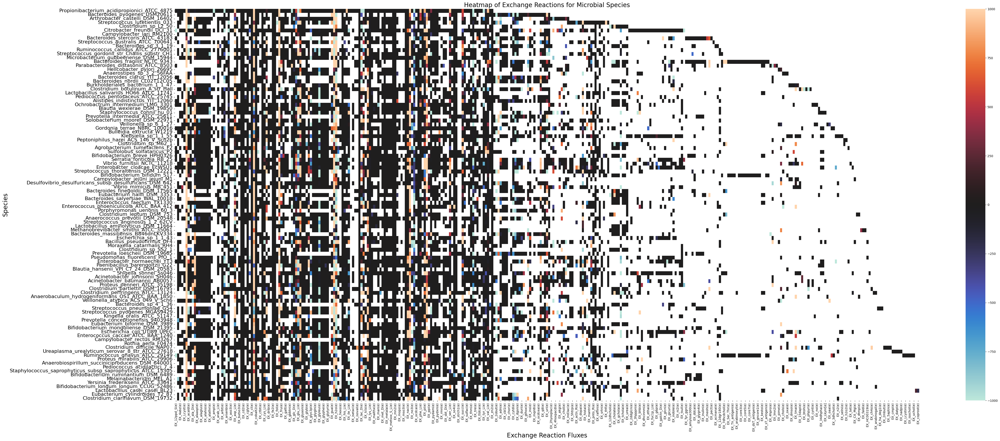

In [13]:
import seaborn as sns

plt.figure(figsize=(50, 20))
sns.heatmap(df, cmap='icefire', cbar=True)
plt.title('Heatmap of Exchange Reactions for Microbial Species', fontsize=20)
plt.xlabel('Exchange Reaction Fluxes', fontsize=20)
plt.ylabel('Species', fontsize=20)
plt.yticks(fontsize=16)
plt.tight_layout()
plt.show()

<p align="justify">The heatmap displays the exchange fluxes for 100 AGORA microbial models, revealing diverse metabolic profiles across species. Notably, the reaction EX_alahis(e) (alanine-histidine exchange) shows variability, with some species having this flux set to zero, while others completely lack the reaction, suggesting differences in metabolic pathways or ecological roles. Additionally, EX_glu_L(e) (L-glutamate exchange) exhibits significantly varying flux across all organisms, highlighting its central role in microbial metabolism. Species with high flux may either secrete glutamate as a metabolic byproduct or uptake it for growth, reflecting ecological adaptations and potential cross-feeding interactions within microbial communities.</p>

**Correlation Matrix Analysis**
<p align="justify">The correlation matrix computes the pairwise linear relationships between all pairs of models (species). It quantifies how similarly two models behave across all exchange reactions.</p>

In [14]:
# Transpose the DataFrame - convert the original structure where each row is a model (species) and each column is a reaction, into a format where the rows represent reactions and the columns represent models.
#This allows the correlation matrix to calculate the relationships between models based on their reaction flux profiles.
df_transposed = df.T

# Compute the correlation matrix between models
model_correlation = pd.DataFrame(df_transposed.corr())
model_correlation

,Propionibacterium_acidipropionici_ATCC_4875,Bacteroides_pyogenes_DSM20611,Arthrobacter_castelli_DSM_16402,Streptococcus_lutetiensis_033,Clostridium_sp_L2_50,Citrobacter_freundii_UCI_31,Campylobacter_lari_RM2100,Bacteroides_stercoris_ATCC_43183,Streptococcus_australis_ATCC_700641,Bacteroides_sp_3_1_19,Ruminococcus_callidus_ATCC_2776001,Streptococcus_gordonii_str_Challis_substr_CH1,Microbacterium_gubbeenense_DSM_15944,Bacteroides_fragilis_NCTC_9343,Parabacteroides_distasonis_ATCC_8503,Helicobacter_pylori_26695,Anaerostipes_sp_3_2_56FAA,Bacteroides_clarus_YIT_12056,Bacteroides_nordii_CL02T12C05,Burkholderiales_bacterium_1_1_47,Clostridium_botulinum_A_str_Hall,Lactobacillus_salivarius_HO66_ATCC_11741,Pediococcus_pentosaceus_ATCC_25745,Alistipes_indistinctus_YIT_12060,Ochrobactrum_intermedium_LMG_3301,Blautia_wexlerae_DSM_19850,Staphylococcus_cohnii_hu_01,Prevotella_intermedia_ATCC_25611,Solobacterium_moorei_DSM_22971,Veillonella_sp_6_1_27,Gordonia_terrae_NBRC_100016,Bulleidia_extructa_W1219,Klebsiella_sp_1_1_55,Peptoniphilus_harei_ACS_146_V_Sch2b,Clostridium_sp_M62_1,Agrobacterium_tumefaciens_F2,Sulfolobus_solfataricus_P2,Bifidobacterium_breve_HPH0326,Serratia_fonticola_RB_25,Vibrio_furnissii_NCTC_11218,Enterobacter_cloacae_EcWSU1,Streptococcus_thoraltensis_DSM_12221,Bifidobacterium_bifidum_S17,Campylobacter_jejuni_jejuni_M1,Desulfovibrio_desulfuricans_subsp_desulfuricans_DSM_642,Vibrio_mimicus_MB_451,Bacteroides_finegoldii_DSM_17565,Eubacterium_hallii_DSM_3353,Bacteroides_salyersiae_WAL_10018,Enterococcus_faecium_TX1330,Enterococcus_phoeniculicola_ATCC_BAA_412,Porphyromonas_uenonis_60_3,Clostridium_leptum_DSM_753,Anaerococcus_prevotii_DSM_20548,Streptococcus_anginosus_1_2_62CV,Lactobacillus_amylolyticus_DSM_11664,Methanobrevibacter_smithii_ATCC_35061,Bacteroides_massiliensis_B846dnLKV334,Escherichia_sp_1_1_43,Bacillus_pseudofirmus_OF4,Moraxella_catarrhalis_RH4,Clostridium_sp_SS2_1,Prevotella_loescheii_DSM_19665,Pseudomonas_fluorescens_PfO_1,Enterobacter_hormaechei_YT3,Paenibacillus_barengoltzii_G22,Blautia_hansenii_VPI_C7_24_DSM_20583,Shigella_sonnei_Ss046,Acinetobacter_johnsonii_SH046,Acinetobacter_baumannii_AB0057,Proteus_penneri_ATCC_35198,Clostridium_bartlettii_DSM_16795,Clostridium_perfringens_ATCC_13124,Anaerobaculum_hydrogeniformans_OS1_ATCC_BAA_1850,Veillonella_atypica_ACS_049_V_Sch6,Bacteroides_sp_4_1_36,Streptococcus_pneumoniae_G54,Streptococcus_pyogenes_MGAS9429,Kingella_oralis_ATCC_51147,Prevotella_conceptionensis_9403948,Eubacterium_biforme_DSM_3989,Bifidobacterium_mongoliense_DSM_21395,Escherichia_coli_UTI89_UPEC,Enterococcus_caccae_ATCC_BAA_1240,Campylobacter_rectus_RM3267,Rothia_aeria_F0474,Clostridium_difficile_NAP07,Ureaplasma_urealyticum_serovar_8_str_ATCC_27618,Ruminococcus_gnavus_ATCC_29149,Proteus_mirabilis_ATCC_29906,Anaerobiospirillum_succiniciproducens_DSM_640001,Pediococcus_acidilactici_7_4,Staphylococcus_saprophyticus_subsp_saprophyticus_ATCC_15305,Bifidobacterium_ruminantium_DSM_6489,Melainabacterium_MEL_A1,Yersinia_frederiksenii_ATCC_33641,Bifidobacterium_longum_longum_CCUG_52486,Lactobacillus_casei_casei_BL23,Eubacterium_cylindroides_T2_87,Clostridium_clariflavum_DSM_19732
Propionibacterium_acidipropionici_ATCC_4875,1.000000,0.535577,0.421492,0.151912,0.544771,0.506544,0.007549,0.388931,0.138612,0.620270,0.148118,0.142313,0.343916,0.562161,0.467377,0.217575,0.081017,0.555871,0.615828,0.175193,0.193655,0.440289,0.061899,0.567967,0.408463,0.176026,0.213180,0.486620,-0.059572,0.517577,0.416674,0.029318,0.415796,0.100354,0.489480,0.368375,0.383898,0.214559,0.520896,0.705323,0.581402,0.098067,0.311855,0.067705,0.361431,0.566446,0.526961,0.357284,0.594619,0.382238,0.346622,0.391660,0.445872,0.039762,0.253988,0.394851,0.320851,0.545446,0.210999,0.159999,0.370118,0.392399,0.490579,0.340082,0.464378,0.144403,0.034131,0.449113,0.422836,0.522144,0.539315,0.354635,0.100740,0.478840,0.102713,0.499980,0.087703,0.009827,0.288436,0.457843,0.294717,0.456281,0.379934,0.188454,-0.051201,0.374424,0.370046,0.060931,0.30

<Figure size 7000x5000 with 0 Axes>

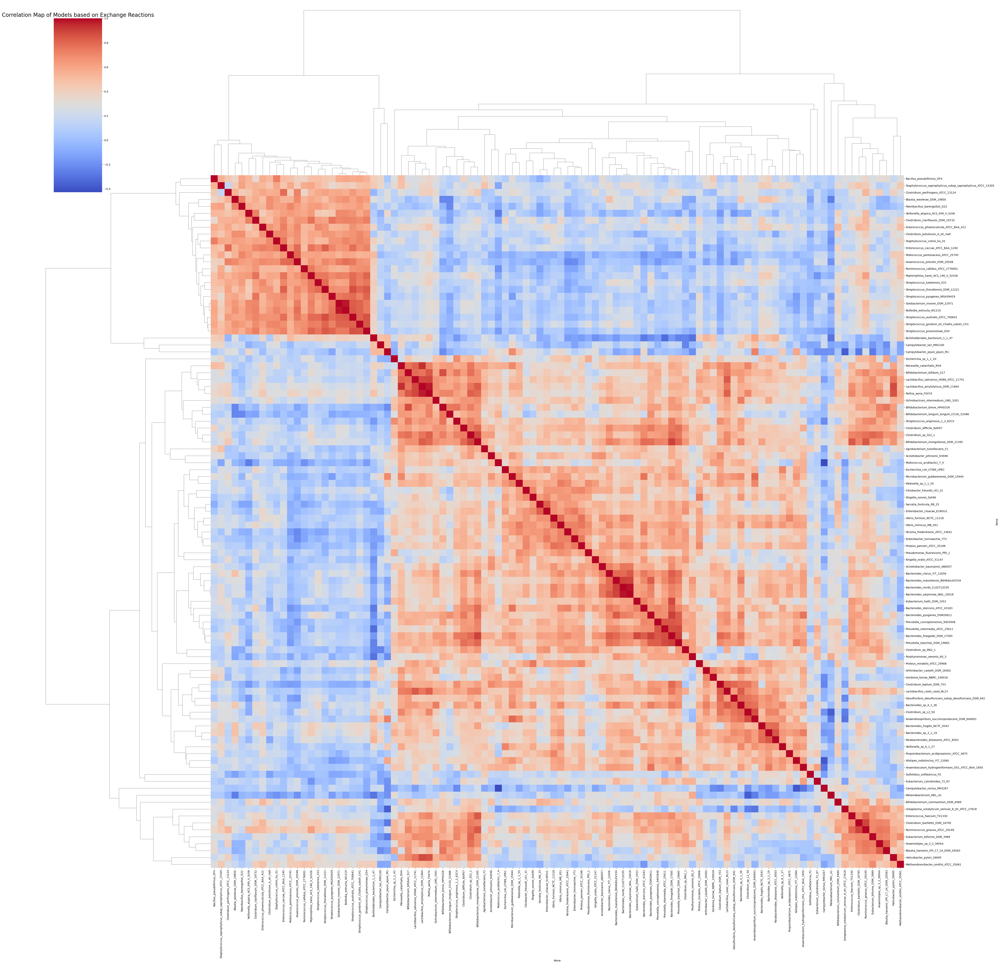

In [15]:
# Create a clustered heatmap using seaborn
plt.figure(figsize=(70, 50))
sns.clustermap(model_correlation, cmap="coolwarm", metric="correlation", method="average", figsize=(50, 50))
plt.title('Correlation Map of Models based on Exchange Reactions', fontsize=20)
sns.set(font_scale=2)

<p align="justify">Red blocks indicate positively correlated species. An example would be bacteria that share similar metaolic pathways. *Clostridium* species are often involved in anaerobic metabolism (e.g., fermentation of sugars to produce butyrate or acetate), and other bacteria in the list could follow similar metabolic routes, leading to positive correlation. *Enterococcus* and *Pediococcus* are often found in environments where they contribute to lactic acid fermentation. Bacteria with similar fermentation pathways will likely show positively correlated exchange fluxes.</p>

**Correlation between exchange reactions**

In [16]:
correlation_matrix = pd.DataFrame(df.corr())
correlation_matrix

,EX_12ppd_S(e),EX_26dap_M(e),EX_4abz(e),EX_4hbz(e),EX_Lcyst(e),EX_ac(e),EX_acald(e),EX_acgam(e),EX_ala_D(e),EX_ala_L(e),EX_alaasp(e),EX_alagln(e),EX_alaglu(e),EX_alagly(e),EX_alahis(e),EX_alaleu(e),EX_alathr(e),EX_alltn(e),EX_amp(e),EX_arab_D(e),EX_arab_L(e),EX_arabttr(e),EX_arbt(e),EX_arg_L(e),EX_arsenb(e),EX_asn_L(e),EX_aso3(e),EX_aso4(e),EX_asp_L(e),EX_btn(e),EX_butso3(e),EX_ca2(e),EX_cd2(e),EX_cellb(e),EX_cgly(e),EX_cit(e),EX_cl(e),EX_co2(e),EX_cobalt2(e),EX_csn(e),EX_ctbt(e),EX_cu2(e),EX_cys_L(e),EX_dcyt(e),EX_drib(e),EX_ethso3(e),EX_fe2(e),EX_fe3(e),EX_fol(e),EX_for(e),EX_fru(e),EX_gal(e),EX_galt(e),EX_gam(e),EX_gbbtn(e),EX_gcald(e),EX_glc_D(e),EX_gln_L(e),EX_glu_L(e),EX_gly(e),EX_glyasn(e),EX_glyasp(e),EX_glyb(e),EX_glyc(e),EX_glyc3p(e),EX_glycys(e),EX_glygln(e),EX_glyglu(e),EX_glyleu(e),EX_glymet(e),EX_glyphe(e),EX_glypro(e),EX_glytyr(e),EX_gthrd(e),EX_gua(e),EX_h(e),EX_h2o(e),EX_h2s(e),EX_hexs(e),EX_hg2(e),EX_his_L(e),EX_hxan(e),EX_ile_L(e),EX_inost(e),EX_isetac(e),EX_isocapr(e),EX_isoval(e),EX_k(e),EX_lac_D(e),EX_lac_L(e),EX_lcts(e),EX_leu_L(e),EX_lys_L(e),EX_malt(e),EX_malthx(e),EX_malttr(e),EX_man(e),EX_melib(e),EX_met_D(e),EX_met_L(e),EX_metala(e),EX_metsox_R_L(e),EX_metsox_S_L(e),EX_mg2(e),EX_mn2(e),EX_mnl(e),EX_mops(e),EX_mqn7(e),EX_mso3(e),EX_na1(e),EX_nac(e),EX_nh4(e),EX_no3(e),EX_o2(e),EX_ocdca(e),EX_pb(e),EX_phe_L(e),EX_pheme(e),EX_pi(e),EX_ppa(e),EX_ppi(e),EX_pro_L(e),EX_pydam(e),EX_pydx(e),EX_pydxn(e),EX_rib_D(e),EX_rmn(e),EX_salcn(e),EX_sbt_D(e),EX_ser_D(e),EX_ser_L(e),EX_sheme(e),EX_so4(e),EX_spmd(e),EX_strch1(e),EX_strch2(e),EX_succ(e),EX_sucr(e),EX_sulfac(e),EX_taur(e),EX_thm(e),EX_thr_L(e),EX_tre(e),EX_trp_L(e),EX_ttdca(e),EX_tym(e),EX_tyr_L(e),EX_ura(e),EX_val_L(e),EX_xyl_D(e),EX_zn2(e),EX_2dmmq8(e),EX_2obut(e),EX_ade(e),EX_adn(e),EX_adocbl(e),EX_cbl1(e),EX_cbl2(e),EX_chor(e),EX_cro4(e),EX_cytd(e),EX_dad_2(e),EX_dgsn(e),EX_din(e),EX_duri(e),EX_gsn(e),EX_gthox(e),EX_h2(e),EX_ins(e),EX_isobut(e),EX_mqn8(e),EX_ncam(e),EX_ocdcea(e),EX_orn(e),EX_q8(e),EX_thymd(e),EX_uri(e),EX_xan(e),EX_2hyoxplac(e),EX_3mop(e),EX_4hoxpacd(e),EX_acac(e),EX_akg(e),EX_but(e),EX_chol(e),EX_fum(e),EX_ind3ac(e),EX_34dhphe(e),EX_5htrp(e),EX_5mthf(e),EX_actn_R(e),EX_diact(e),EX_dopa(e),EX_etoh(e),EX_hista(e),EX_mal_L(e),EX_mantr(e),EX_no2(e),EX_pnto_R(e),EX_ptrc(e),EX_raffin(e),EX_ribflv(e),EX_srtn(e),EX_stys(e),EX_thf(e),EX_trypta(e),EX_12dhchol(e),EX_C02528(e),EX_cholate(e),EX_dgchol(e),EX_gchola(e),EX_nmn(e),EX_tchola(e),EX_tdchola(e),EX_urea(e),EX_13ppd(e),EX_2ddglcn(e),EX_3hcinnm(e),EX_3hpppn(e),EX_4abut(e),EX_bhb(e),EX_crn(e),EX_dhcinnm(e),EX_dhpppn(e),EX_etha(e),EX_fecrm(e),EX_fuc1p_L(e),EX_fuc_L(e),EX_g6p(e),EX_galct_D(e),EX_galctn_D(e),EX_galur(e),EX_glcn(e),EX_glcr(e),EX_glcur(e),EX_hdca(e),EX_indole(e),EX_man6p(e),EX_ni2(e),EX_pppn(e),EX_tsul(e),EX_xtsn(e),EX_Tyr_ggn(e),EX_amylopect900(e),EX_amylose300(e),EX_chtbs(e),EX_ddca(e),EX_glygn2(e),EX_glygn4(e),EX_glygn5(e),EX_inulin(e),EX_kestopt(e),EX_meoh(e),EX_pac(e),EX_pect(e),EX_pullulan1200(e),EX_acmana(e),EX_dextrin(e),EX_12dgr180(e),EX_acnam(e),EX_7dhcdchol(e),EX_7ocholate(e),EX_Ser_Thr(e),EX_T_antigen(e),EX_Tn_antigen(e),EX_acgal(e),EX_arabinoxyl(e),EX_core2(e),EX_core3(e),EX_core4(e),EX_core5(e),EX_core6(e),EX_core7(e),EX_core8(e),EX_dsT_antigen(e),EX_f1a(e),EX_gncore1(e),EX_gncore2(e),EX_kesto(e),EX_kestottr(e),EX_sT_antigen(e),EX_sTn_antigen(e),EX_4hpro(e),EX_glyclt(e),EX_lmn2(e),EX_lmn30(e),EX_pime(e),EX_pyr(e),EX_chols(e),EX_hom_L(e),EX_oxa(e),EX_dms(e),EX_dmso(e),EX_so3(e),EX_tma(e),EX_tmao(e),EX_15dap(e),EX_4hphac(e),EX_btoh(e),EX_ind3ppa(e),EX_phpyr(e),EX_r34hpp(e),EX_cynt(e),EX_n2o(e),EX_no(e),EX_mobd(e),EX_34dhpha(e),EX_3hphac(e),EX_Lkynr[e],EX_isoprene(e),EX_oaa(e),EX_3dhcdchol(e),EX_3dhchol(e),EX_btd_RR(e),EX_n2(e),EX_sel(e),EX_selni(e),EX_glutar(e),EX_h2o2(e),EX_lyx_L(e),EX_tet(e),EX_5mta(e),EX_Cit_Mg(e),EX_dpcoa(e),EX_dtmp(e),EX_ch4(e),EX_fald(e),EX_hco3(e),EX_HC00319(e),EX_idon_L(e),EX_ch4s(e),EX_arabinan101(e),EX_arabinogal(e),EX_ha(e),EX_ha_deg1(e),EX

In [17]:
# Dropping the columns and rows if all values of NaN for plotting purposes
correlation_matrix_cleaned = correlation_matrix.dropna(axis=1, how='all').dropna(axis=0, how='all')
correlation_matrix_cleaned

,EX_12ppd_S(e),EX_26dap_M(e),EX_4abz(e),EX_4hbz(e),EX_ac(e),EX_acald(e),EX_acgam(e),EX_ala_D(e),EX_ala_L(e),EX_alaasp(e),EX_alagln(e),EX_alaglu(e),EX_alagly(e),EX_alahis(e),EX_alaleu(e),EX_alathr(e),EX_amp(e),EX_arab_D(e),EX_arab_L(e),EX_arabttr(e),EX_arbt(e),EX_arg_L(e),EX_asn_L(e),EX_asp_L(e),EX_ca2(e),EX_cellb(e),EX_cgly(e),EX_cit(e),EX_cl(e),EX_co2(e),EX_cobalt2(e),EX_csn(e),EX_cu2(e),EX_cys_L(e),EX_dcyt(e),EX_drib(e),EX_fe2(e),EX_fe3(e),EX_fol(e),EX_for(e),EX_fru(e),EX_gal(e),EX_gam(e),EX_gbbtn(e),EX_gcald(e),EX_glc_D(e),EX_gln_L(e),EX_glu_L(e),EX_gly(e),EX_glyasn(e),EX_glyasp(e),EX_glyb(e),EX_glyc(e),EX_glyc3p(e),EX_glycys(e),EX_glygln(e),EX_glyleu(e),EX_glymet(e),EX_glyphe(e),EX_glypro(e),EX_glytyr(e),EX_gthrd(e),EX_gua(e),EX_h(e),EX_h2o(e),EX_h2s(e),EX_his_L(e),EX_hxan(e),EX_ile_L(e),EX_isoval(e),EX_k(e),EX_lac_D(e),EX_lac_L(e),EX_lcts(e),EX_leu_L(e),EX_lys_L(e),EX_malt(e),EX_malthx(e),EX_malttr(e),EX_man(e),EX_melib(e),EX_met_L(e),EX_metala(e),EX_metsox_S_L(e),EX_mg2(e),EX_mn2(e),EX_mnl(e),EX_mqn7(e),EX_nac(e),EX_nh4(e),EX_no3(e),EX_o2(e),EX_ocdca(e),EX_phe_L(e),EX_pheme(e),EX_pi(e),EX_ppa(e),EX_ppi(e),EX_pro_L(e),EX_pydam(e),EX_pydx(e),EX_pydxn(e),EX_rib_D(e),EX_rmn(e),EX_salcn(e),EX_ser_L(e),EX_sheme(e),EX_so4(e),EX_spmd(e),EX_succ(e),EX_sucr(e),EX_taur(e),EX_thm(e),EX_thr_L(e),EX_tre(e),EX_trp_L(e),EX_ttdca(e),EX_tym(e),EX_tyr_L(e),EX_ura(e),EX_val_L(e),EX_xyl_D(e),EX_zn2(e),EX_2dmmq8(e),EX_2obut(e),EX_ade(e),EX_adn(e),EX_adocbl(e),EX_chor(e),EX_cytd(e),EX_dad_2(e),EX_dgsn(e),EX_din(e),EX_duri(e),EX_gsn(e),EX_gthox(e),EX_h2(e),EX_ins(e),EX_isobut(e),EX_mqn8(e),EX_ncam(e),EX_orn(e),EX_q8(e),EX_thymd(e),EX_uri(e),EX_xan(e),EX_3mop(e),EX_acac(e),EX_akg(e),EX_but(e),EX_chol(e),EX_fum(e),EX_34dhphe(e),EX_actn_R(e),EX_diact(e),EX_dopa(e),EX_etoh(e),EX_mal_L(e),EX_mantr(e),EX_no2(e),EX_pnto_R(e),EX_ptrc(e),EX_raffin(e),EX_ribflv(e),EX_stys(e),EX_thf(e),EX_12dhchol(e),EX_C02528(e),EX_cholate(e),EX_nmn(e),EX_tchola(e),EX_urea(e),EX_2ddglcn(e),EX_4abut(e),EX_bhb(e),EX_crn(e),EX_dhpppn(e),EX_etha(e),EX_g6p(e),EX_galct_D(e),EX_galur(e),EX_glcn(e),EX_glcr(e),EX_glcur(e),EX_indole(e),EX_man6p(e),EX_pppn(e),EX_xtsn(e),EX_chtbs(e),EX_ddca(e),EX_inulin(e),EX_meoh(e),EX_pac(e),EX_acmana(e),EX_dextrin(e),EX_12dgr180(e),EX_acnam(e),EX_7dhcdchol(e),EX_7ocholate(e),EX_arabinoxyl(e),EX_4hpro(e),EX_glyclt(e),EX_pyr(e),EX_chols(e),EX_oxa(e),EX_so3(e),EX_tma(e),EX_tmao(e),EX_4hphac(e),EX_ind3ppa(e),EX_phpyr(e),EX_oaa(e),EX_3dhcdchol(e),EX_3dhchol(e),EX_btd_RR(e),EX_5mta(e),EX_dpcoa(e),EX_dtmp(e),EX_fald(e),EX_ch4s(e)
EX_12ppd_S(e),1.000000,-0.094774,0.448402,0.377501,-0.156811,0.052109,-0.203195,0.124863,-0.200081,NaN,NaN,NaN,NaN,0.073106,NaN,NaN,-0.725321,NaN,NaN,NaN,NaN,0.338415,0.288169,-0.067247,0.247182,NaN,-0.140767,0.208614,0.247182,-0.117411,0.247182,-0.091731,0.247182,0.185047,0.063987,NaN,0.028654,0.012351,-0.466897,-0.163253,0.014362,0.108247,NaN,NaN,-0.127340,0.683135,-0.078743,-0.316462,-0.113608,NaN,NaN,NaN,0.203532,0.270181,NaN,NaN,0.122471,0.678399,NaN,0.676036,NaN,-0.167053,0.008899,0.117251,0.025290,-0.203625,0.052159,0.136952,0.397734,NaN,0.247182,-0.267052,0.595546,NaN,-0.208424,0.108113,NaN,-0.175955,NaN,-0.082104,NaN,-0.277548,-0.197555,-0.128751,0.247182,0.247182,0.091731,NaN,-0.098007,-0.204639,0.113960,-0.421831,0.318725,0.026722,0.457332,-0.288449,-0.284918,0.144920,0.123211,-0.093380,0.199316,0.232069,-0.117612,-0.139125,-0.111632,0.179276,0.546899,0.138718,-0.039091,0.234196,-0.171612,-0.679366,0.307587,-0.310217,-0.175153,0.136146,-0.243559,NaN,-0.170435,0.072011,-0.061819,-0.094893,0.247182,-0.763820,NaN,NaN,-0.073546,-0.083629,NaN,-0.184937,-0.032910,-0.160710,0.340543,-0.077204,-0.487468,-1.000000,NaN,-0.818104,NaN,-0.469954,NaN,-0.357614,-0.892015,0.391074,0.218116,0.111839,-0.560863,NaN,0.736527,0.597761,-1.000000,0.363506,NaN,NaN,NaN,NaN,-0.163416,-0.142540,NaN,0.626343,0.218144,-0.272371,NaN,-0.766471,-0.152156,NaN,NaN,1.000000,0.142857,-0.794880,1.000000,NaN,NaN,0.333333,0.274458,NaN,-1.000000,-0.500000,

In [18]:
# Number of exchange reactions with a numerical correlation
correlation_matrix_cleaned.shape

(220, 220)

<Figure size 7000x7000 with 0 Axes>

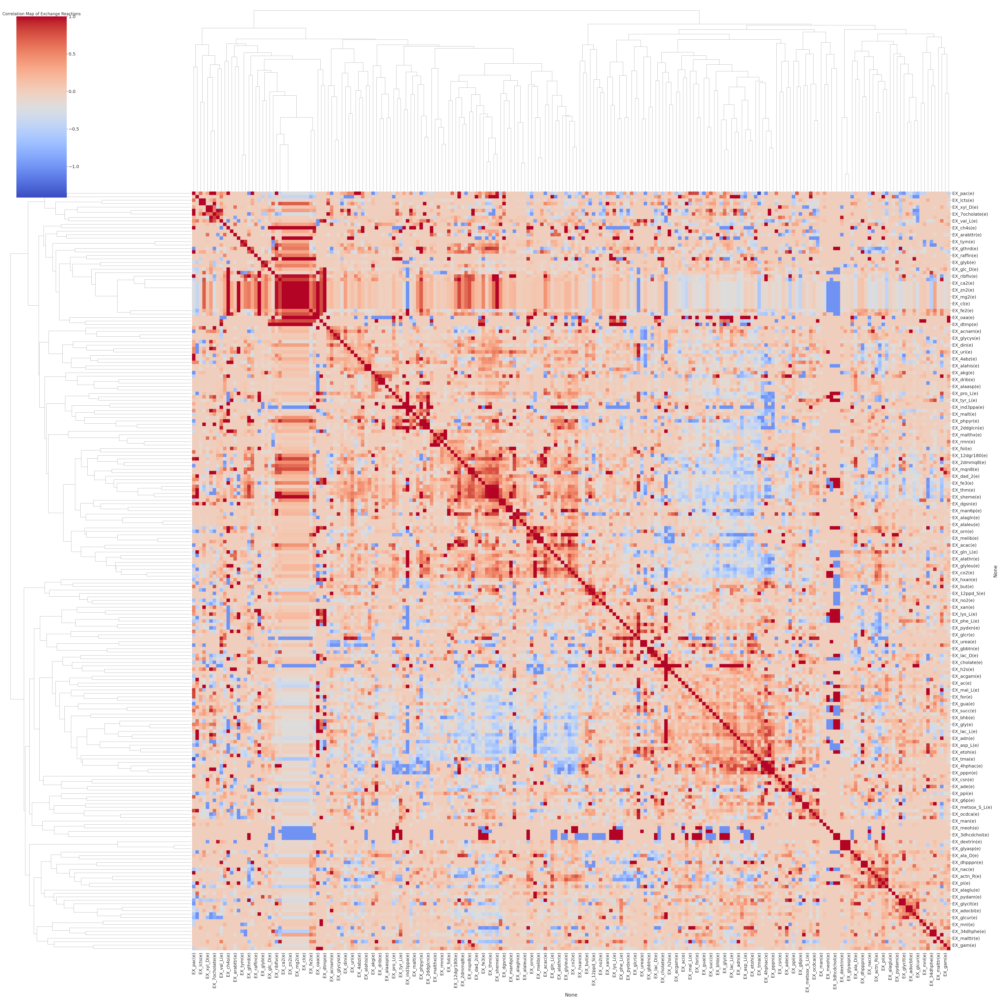

In [19]:
plt.figure(figsize=(70, 70))
correlation_matrix_cleaned_filled = correlation_matrix_cleaned.fillna(0)
sns.clustermap(correlation_matrix_cleaned_filled, cmap="coolwarm", metric="correlation", method="average", figsize=(70,70))
plt.title('Correlation Map of Exchange Reactions', fontsize=20)
sns.set(font_scale=2)
plt.show()

<p align="justify">The red block of highly positively correlated exchange reactions includes reactions for the uptake or secretion of several metabolites and ions, such as EX_ribflv(e) (riboflavin), EX_ca2(e) (calcium), EX_zn2(e) (zinc), EX_mg2(e) (magnesium), EX_cl(e) (chloride), and EX_fe2(e) (iron). These reactions primarily represent the uptake of essential nutrients and ions that are critical for the growth and survival of many organisms. Riboflavin (EX_ribflv(e)) is a precursor for flavin cofactors like FAD and FMN, which are crucial for metabolic pathways such as energy production.Calcium (EX_ca2(e)), magnesium (EX_mg2(e)), and zinc (EX_zn2(e)) are essential cofactors for enzymes, stabilize cell membranes, and play roles in signaling.</p>

## **Dimensionality Reduction**
<p align="justify">Dimensionality reduction is a technique used in data analysis to simplify complex datasets by reducing the number of variables (or dimensions) while retaining as much meaningful information as possible. In biological datasets, such as exchange reaction fluxes from microbial models, the data often have a high dimensionality, meaning there are many features (e.g., reactions) for each organism. This high dimensionality can make visualization, interpretation, and downstream analyses challenging due to redundancy and noise.</p>

**Principal Component Analysis (PCA)**
<p align="justify">PCA is a widely used technique that transforms the original data into a set of orthogonal components (principal components), each representing a direction of maximum variance in the data. The first few principal components often capture most of the variance, allowing us to represent the data in a lower-dimensional space while preserving the most important patterns.</p>

**Identifying the number of PCA components that best capture 90 - 95% variance**

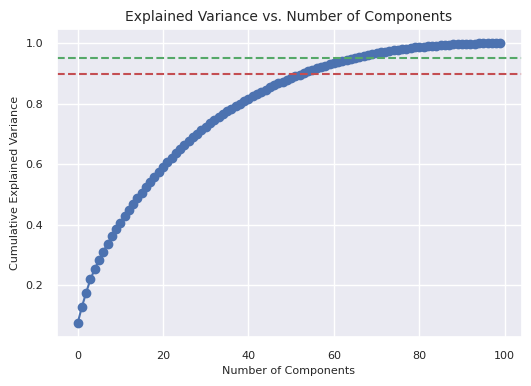

In [20]:
from sklearn.decomposition import PCA
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler

X = df.values
species = [s[0] for s in df.index]

# If your columns are tuples, flatten them
df.columns = ['_'.join(map(str, col)) if isinstance(col, tuple) else str(col) for col in df.columns]

# Initialize SimpleImputer with constant strategy to replace missing fluxes with 0
imputer = SimpleImputer(strategy='constant', fill_value=0)
df_imputed = pd.DataFrame(imputer.fit_transform(df), columns=df.columns)

# Standardize the data
scaler = StandardScaler()
scaled_data = scaler.fit_transform(df_imputed)

# Apply PCA
pca = PCA()
pca.fit(scaled_data)

# Plotting the explained variance
plt.figure(figsize=(6, 4))
plt.plot(np.cumsum(pca.explained_variance_ratio_), marker='o')
plt.xlabel('Number of Components', fontsize=8)
plt.ylabel('Cumulative Explained Variance', fontsize=8)
plt.title('Explained Variance vs. Number of Components', fontsize=10)
plt.tick_params(axis='both', labelsize=8)
plt.axhline(y=0.90, color='r', linestyle='--')  # Example for 90% variance
plt.axhline(y=0.95, color='g', linestyle='--')  # Example for 95% variance
plt.show()

<p align="justify">The explained variance curve shows that you need at least 60 components to capture 90-95% variance of the data. This observation highlights the complexity and high dimensionality of the dataset, where the variance is distributed across many components rather than being concentrated in just a few. </p>

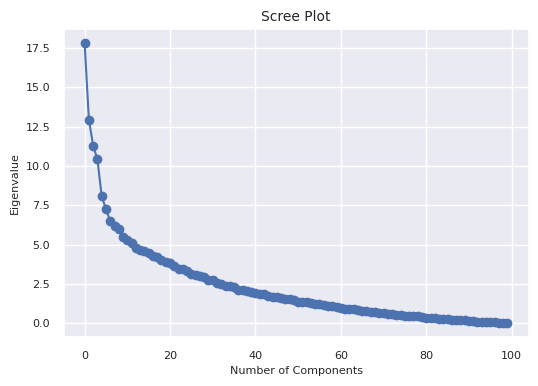

In [21]:
# Plotting the Scree plot
plt.figure(figsize=(6, 4))
plt.plot(pca.explained_variance_, marker='o')
plt.xlabel('Number of Components', fontsize=8)
plt.ylabel('Eigenvalue', fontsize=8)
plt.title('Scree Plot', fontsize=10)
plt.tick_params(axis='both', labelsize=8)
plt.show()

<p align="justify">The scree plot is a graphical representation used in PCA to show the amount of variance explained by each principal component (PC). It is a useful tool to determine how many components are needed to capture most of the information in the data. The scree plot typically shows a steep decline in variance explained for the first few components, followed by a leveling-off (or "elbow"). The "elbow" indicates the point where additional components add diminishing amounts of variance. Components before the elbow are usually the most important for explaining the data.</p>

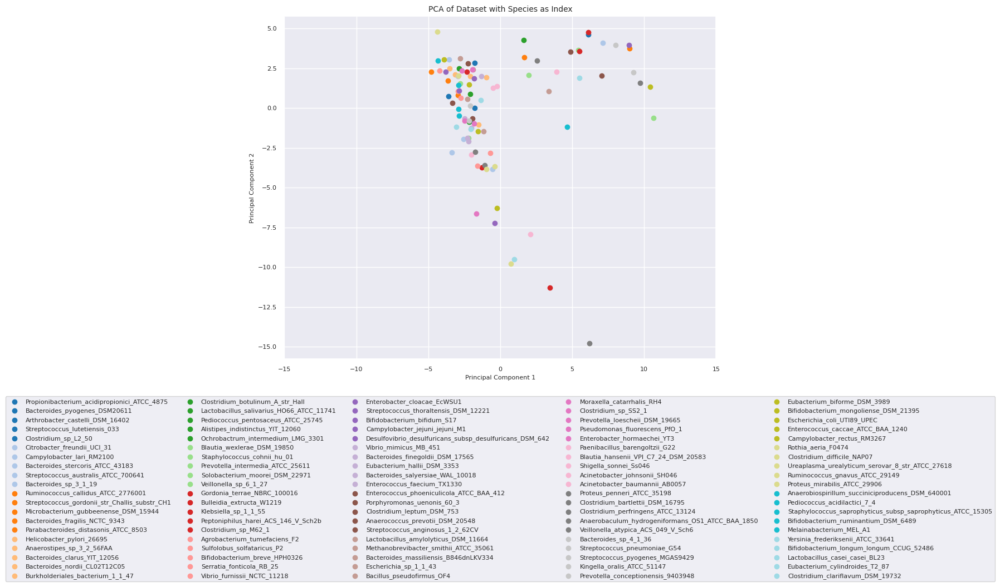

In [22]:
# Perform PCA to reduce dimensions to 60
pca = PCA(n_components=60)
X_r = pca.fit_transform(scaled_data)

# Create the scatter plot
plt.figure(figsize=(10, 8))
colormap = plt.colormaps['tab20'] # Get a color map
colors = colormap(np.linspace(0, 1, len(species)))
species_to_color = {name: colors[i] for i, name in enumerate(species)}

# Plot each species using the unique species names directly
for i in range(X_r.shape[0]):
    plt.scatter(X_r[i , 0], X_r[i, 1], color=species_to_color[species[i]], label=species[i])

plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.1), ncol=5, fontsize=8)  # Adjust this to move the legend
# Set axis limits to center (0, 0)
plt.xlim([-15, 15])  # Adjust these limits as necessary
plt.title('PCA of Dataset with Species as Index', fontsize=10)
plt.xlabel('Principal Component 1', fontsize=8)
plt.ylabel('Principal Component 2', fontsize=8)
plt.tick_params(axis='both', labelsize=8)
plt.show()

<p align="justify">This 2D PCA plot visualizes the metabolic profiles of 100 AGORA models based on their exchange reaction fluxes. Each point represents a microbial species, with its position determined by the first two principal components, which capture the largest variance in the dataset.</p>

In [23]:
# Get the principal components
components = pca.components_  # Shape: (n_components, n_features)

# Get the explained variance
explained_variance = pca.explained_variance_ratio_

# Create a DataFrame to show loadings
loadings_df = pd.DataFrame(components.T, columns=[f'PC{i+1}' for i in range(components.shape[0])], index=df.columns)
loadings_df

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13,PC14,PC15,PC16,PC17,PC18,PC19,PC20,PC21,PC22,PC23,PC24,PC25,PC26,PC27,PC28,PC29,PC30,PC31,PC32,PC33,PC34,PC35,PC36,PC37,PC38,PC39,PC40,PC41,PC42,PC43,PC44,PC45,PC46,PC47,PC48,PC49,PC50,PC51,PC52,PC53,PC54,PC55,PC56,PC57,PC58,PC59,PC60
EX_12ppd_S(e),5.713783e-03,4.262311e-02,3.355370e-02,-3.016972e-02,-9.357291e-04,4.332753e-04,1.312488e-01,-8.315568e-02,-2.318667e-01,-5.646393e-02,5.244763e-02,-1.294314e-01,-8.147771e-02,3.979091e-02,2.495772e-02,-3.774205e-02,6.000028e-02,5.127858e-02,6.670014e-02,-4.198758e-03,-3.527761e-02,4.843601e-02,-1.960551e-02,-8.694058e-03,3.284888e-02,-2.648568e-02,-7.875704e-02,3.526391e-02,5.623584e-02,7.867215e-02,-1.145342e-01,-5.759977e-02,-5.356698e-02,-2.061056e-02,4.444365e-02,1.617055e-01,-5.150081e-03,2.790193e-02,5.097525e-02,1.085176e-01,1.946297e-02,-2.464332e-02,-2.571720e-02,-4.828291e-02,-1.023726e-02,1.898388e-02,-5.698407e-02,2.295683e-02,-7.750845e-02,-3.319045e-02,1.073476e-02,6.377280e-02,-6.716337e-03,8.974761e-02,7.917323e-03,-4.154134e-02,2.487954e-02,-1.289155e-02,1.061191e-02,8.469764e-03
EX_26dap_M(e),3.113625e-02,-2.740910e-02,-3.099248e-03,1.371158e-02,1.112414e-02,1.370031e-02,-2.176822e-02,2.621114e-02,-1.877331e-03,-2.714328e-02,2.996362e-02,-1.798020e-02,-1.112889e-02,-4.799430e-03,2.538898e-03,4.046650e-02,-6.251775e-02,-6.297949e-02,1.734514e-02,-5.073577e-02,3.144553e-02,5.377704e-02,-9.823020e-02,-1.264209e-02,-5.525228e-02,-1.103146e-02,6.218502e-02,-1.816898e-02,1.528648e-01,-1.319427e-01,-1.827025e-01,1.376068e-01,-4.790463e-02,-3.046882e-01,-7.185809e-02,-1.784427e-02,2.289332e-01,1.009738e-01,-6.940762e-02,-8.437722e-03,8.025192e-02,4.225240e-03,-2.799144e-02,6.674097e-02,-1.773752e-02,1.166999e-01,5.633857e-03,-1.869071e-02,1.654461e-02,-4.526183e-02,-1.849029e-02,4.438270e-02,-2.135206e-02,-6.804943e-02,2.766951e-02,-7.773664e-02,5.354637e-02,8.210671e-02,-4.218063e-02,-2.544382e-03
EX_4abz(e),-3.977932e-02,5.129175e-02,1.681207e-01,5.472314e-02,-9.567018e-02,-3.878918e-04,-1.865237e-02,-8.255132e-02,8.631361e-03,-2.432126e-03,4.084503e-03,4.040100e-03,8.849932e-03,-6.422315e-02,-1.478246e-02,-2.674141e-02,7.104862e-02,-2.238060e-02,6.401702e-02,-1.173019e-03,-2.193052e-02,6.482945e-02,-8.378945e-02,2.671469e-03,-8.549328e-02,4.039471e-02,-1.969679e-02,-7.278974e-02,3.818964e-02,-4.520249e-02,1.339538e-02,8.033097e-02,-2.800111e-02,-8.737704e-02,4.195149e-02,-1.657948e-02,-4.730979e-02,-6.229024e-03,1.044186e-01,4.756557e-02,-5.558335e-02,-5.315686e-02,-5.478480e-02,-1.523693e-01,5.256478e-03,-1.081614e-01,1.521750e-02,7.609212e-02,-9.540920e-02,3.659093e-02,-3.689630e-02,4.612475e-03,5.081334e-04,2.348685e-02,-1.039536e-01,-8.332122e-02,7.759551e-03,-7.904727e-02,9.637864e-02,5.872054e-02
EX_4hbz(e),-1.261138e-02,-1.598515e-02,-3.621862e-02,2.652622e-03,-2.180287e-02,-2.783499e-03,2.167344e-02,8.383030e-03,3.499056e-03,-1.315447e-02,-2.585160e-02,1.018359e-02,-2.527408e-03,1.392446e-03,5.232145e-02,-2.104147e-02,-4.474383e-02,8.417628e-03,7.691813e-02,-2.753370e-02,4.658956e-03,6.645309e-02,-5.676539e-02,-1.018082e-01,-4.465434e-02,-1.413162e-02,-8.557036e-02,-6.710717e-02,6.294165e-02,-1.167891e-01,-3.078974e-02,2.758203e-02,-2.784997e-04,6.612278e-02,3.588898e-01,-1.382172e-02,-6.453896e-02,8.267488e-02,-6.119916e-04,1.930060e-02,-2.369723e-02,-4.564408e-03,-4.699920e-02,-4.577950e-02,-7.048023e-02,-6.375222e-02,-1.504815e-01,-1.772889e-01,-2.682560e-02,1.562346e-02,9.818581e-02,-1.970176e-01,4.727897e-02,-1.257312e-01,-1.673887e-02,2.059107e-01,-1.460240e-01,-1.326580e-02,-1.298790e-01,4.044786e-02
EX_Lcyst(e),3.117789e-18,-1.420982e-17,-6.165021e-18,9.609580e-18,-6.905649e-17,2.936901e-17,-3.782374e-17,2.280598e-17,1.080822e-17,3.287060e-17,3.828794e-17,-2.364624e-18,-2.494945e-17,-4.795275e-17,-1.053016e-17,-2.393075e-17,-7.506838e-17,-1.111826e-17,-3.702350e-17,7.098147e-18,-2.290848e-17,-5.540011e-17,-7.221919e-17,1.253964e-17,3.297047e-17,-3.964954e-17,-9.507446e-17,6.147139e-18,-2.431578e-1

<p align="justify">This DataFrame contains the loadings for each exchange reaction (rows) across all principal components (columns). The loadings represent how much each reaction contributes to a given principal component, providing insight into which reactions drive the variability captured by each component. This allows for the identification of key reactions that differentiate microbial models based on their metabolic profiles.</p>

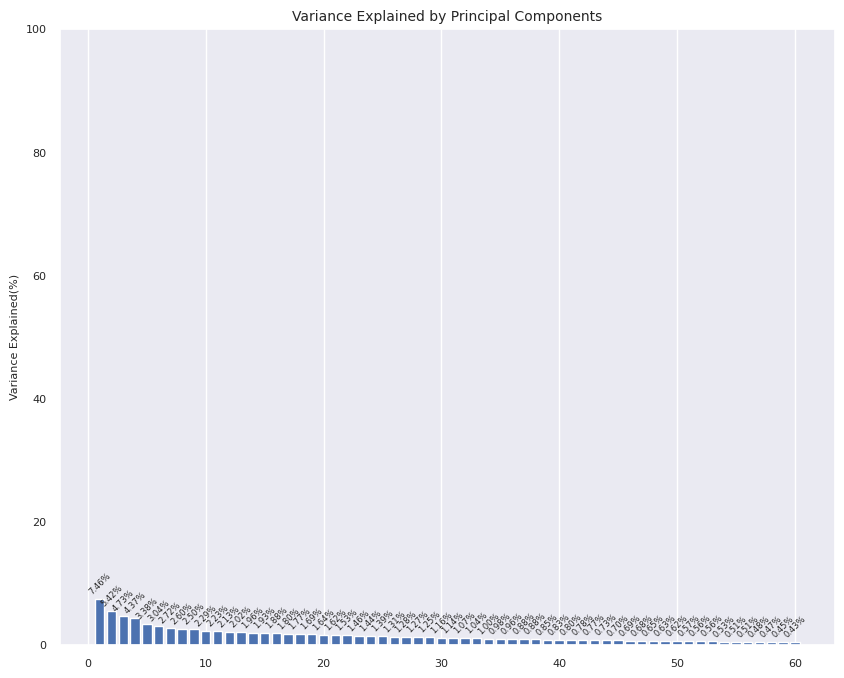

In [24]:
# Create a bar plot for the explained variance
plt.figure(figsize=(10, 8))
plt.bar(range(1,61), explained_variance*100, color='b')
plt.title('Variance Explained by Principal Components', fontsize=10)
plt.ylabel('Variance Explained(%)', fontsize=8)
# Add value labels on top of the bars
for i, v in enumerate(explained_variance*100):
    plt.text(i+1, v+0.5, f"{v:.2f}%", ha='center', va='bottom', fontsize=6, rotation=45)

plt.ylim(0, 100)  # Set y-limits from 0 to 1
plt.tick_params(axis='both', labelsize=8)
plt.grid(axis='y')
plt.show()

<p align="justify">The variance plot indicates that only ~13% of the variance is captured by the first two principal components. More than 85% of the variance is therefore lost with this approach of dimensionality reduction.</p>

**K-Means Clustering**

<p align="justify">K-Means is an unsupervised machine learning algorithm used to group data points into distinct clusters based on their similarities. The algorithm works by iteratively:</p>

1) Initializing Cluster Centers: Randomly selecting k initial cluster centroids.

2) Assigning Data Points: Assigning each point to the nearest cluster center based on a distance metric (e.g., Euclidean distance).

3) Updating Centroids: Recalculating the centroids as the mean of all points assigned to each cluster.

**Determining the optimal number of clusters for K Means Clustering - The Elbow Method**

It works by measuring the inertia (also called within-cluster sum of squares, WCSS), which quantifies how compact the clusters are. The "elbow point" in the curve, where the inertia stops decreasing significantly is the optimal number of clusters, as adding more clusters beyond this point provides diminishing returns.

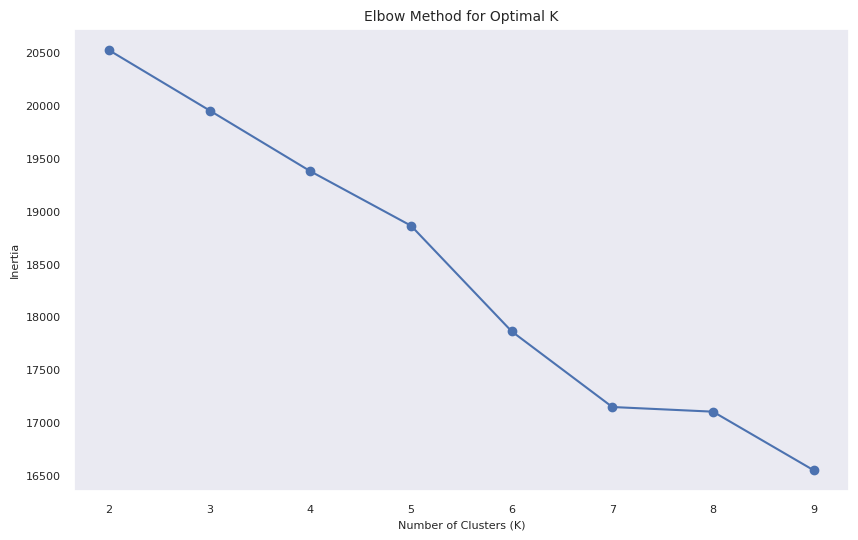

In [25]:
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

# Initialize lists to store inertia and silhouette scores
inertia = []
silhouette_scores = []
k_range = range(2, 10)

for k in k_range:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(X_r)
    inertia.append(kmeans.inertia_)  # Sum of squared distances to closest cluster center
    silhouette_scores.append(silhouette_score(X_r, kmeans.labels_))  # Silhouette score

# Elbow Method Plot
plt.figure(figsize=(10, 6))
plt.plot(k_range, inertia, marker='o')
plt.title('Elbow Method for Optimal K', fontsize=10)
plt.xlabel('Number of Clusters (K)', fontsize=8)
plt.ylabel('Inertia', fontsize=8)
plt.xticks(k_range)
plt.tick_params(axis='both', labelsize=8)
plt.grid()
plt.show()

<p align="justify"> From the plot above, we can see that the 'elbow' is not very defined or less distinct. This can be due to the high dimensional nature of the data where even PCA reduced data might still have some noise. Therefore, an alternative metric such as silhouette score can be considered.</p>

**Silhouette Score**

The Silhouette Score is a metric used to evaluate the quality of clustering in unsupervised learning. It measures how well each data point fits within its assigned cluster compared to other clusters, providing insight into the separability and cohesion of the clusters.


*   Scores closer to 1: Well-separated clusters.
*   Scores around 0: Overlapping or poorly defined clusters.
*   Negative scores: Poor clustering (e.g., misclassification).

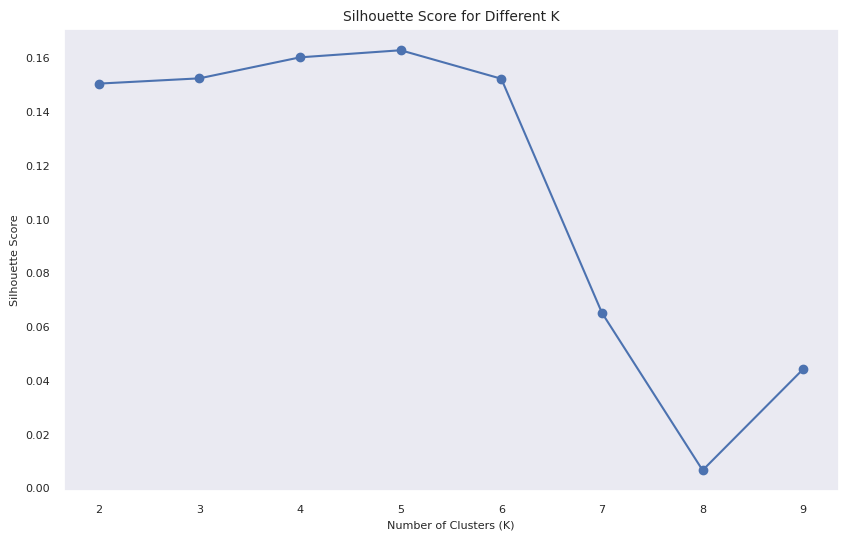

In [26]:
# Silhouette Score Plot
plt.figure(figsize=(10, 6))
plt.plot(k_range, silhouette_scores, marker='o')
plt.title('Silhouette Score for Different K', fontsize=10 )
plt.xlabel('Number of Clusters (K)', fontsize=8)
plt.ylabel('Silhouette Score', fontsize=8)
plt.xticks(k_range)
plt.tick_params(axis='both', labelsize=8)
plt.grid()
plt.show()

<p aling="justify">From the Silhouette Score plot, it can be seen that the highest score is obtained when the cluster number is 5. However, it should also be noted that the value of silhouette score is very close to 0 indicating that the clusters are poorly defined.</p>

**K-Means clustering on dimensionality reduced data**

Lower-dimensional data removes irrelevant variability that might negatively affect clustering. K-Means performs faster and more accurately on fewer dimensions.


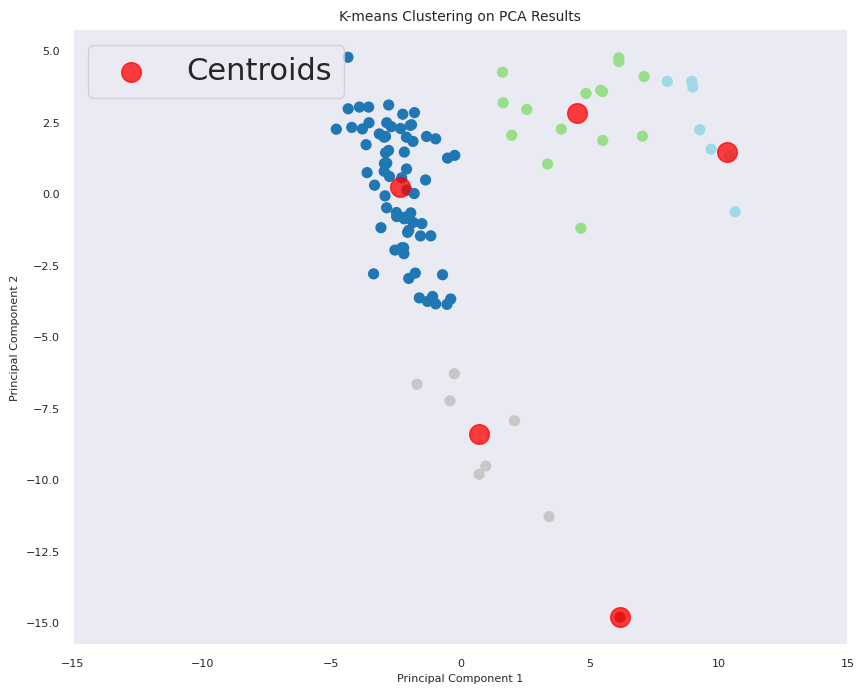

In [27]:
from sklearn.cluster import KMeans

# Performing K-means clustering
n_clusters = 5  # Set the number of clusters
kmeans = KMeans(n_clusters=n_clusters, random_state=0)
y_kmeans = kmeans.fit_predict(X_r[:,:2])

# Step 2: Create the plot
plt.figure(figsize=(10, 8))
plt.scatter(X_r[:, 0], X_r[:, 1], c=y_kmeans, s=50, cmap='tab20')  # Clustered points
centers = kmeans.cluster_centers_
plt.scatter(centers[:, 0], centers[:, 1], c='red', s=200, alpha=0.75, label='Centroids')

# Step 3: Add titles and labels
plt.title('K-means Clustering on PCA Results', fontsize=10)
plt.xlabel('Principal Component 1', fontsize=8)
plt.ylabel('Principal Component 2', fontsize=8)
plt.tick_params(axis='both', labelsize=8)
# Set axis limits to center (0, 0)
plt.xlim([-15, 15])  # Adjust these limits as necessary
plt.legend()
plt.grid()
plt.show()

K-Means clustering performed on PCA redcued data identifies 5 separate clusters as indicated.

**PCA Biplot with K-Means Clustering and Top Features**

<p align="justify">This PCA biplot combines dimensionality reduction with clustering analysis to visualize 100 microbial metabolic models. Each point represents a model, colored by its assigned K-Means cluster, revealing distinct groupings in the reduced space. The top 5 contributing features (exchange reactions) are shown as vectors, with their lengths and directions indicating their relative influence on the principal components.</p>

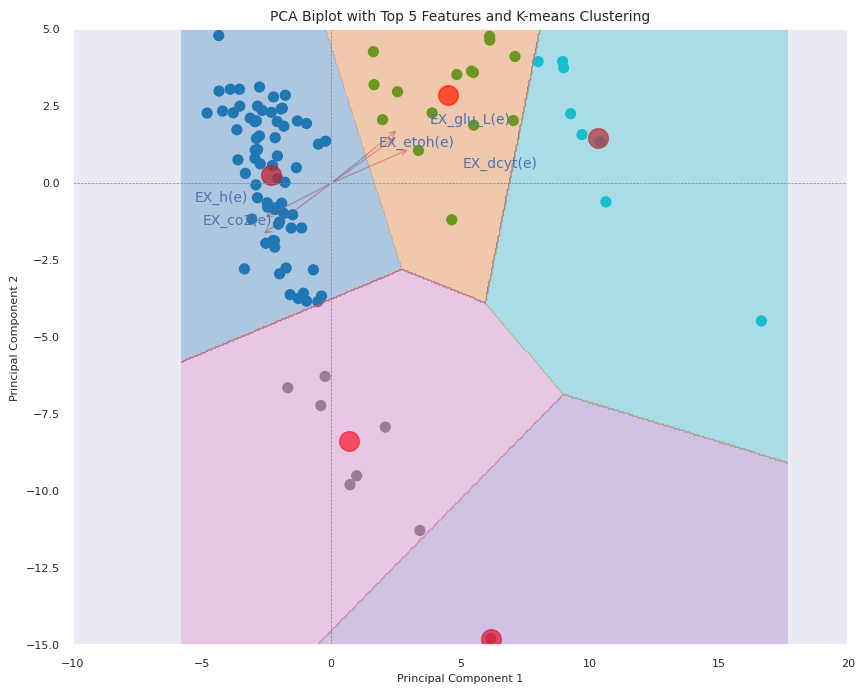

In [28]:
from matplotlib.patches import FancyArrowPatch
from adjustText import adjust_text

# Fit KMeans on the first two components only
kmeans = KMeans(n_clusters=5, random_state=0)  # Adjust n_clusters as needed
kmeans.fit(X_r[:,:2])  # Fit KMeans using the first two components

# Get PCA loadings
loadings = pca.components_.T * np.sqrt(pca.explained_variance_)

# Create a biplot
plt.figure(figsize=(10, 8))

# Scatter plot of PCA results colored by clusters
plt.scatter(X_r[:, 0], X_r[:, 1], c=y_kmeans, s=50, cmap='tab10', label='Models')
centers = kmeans.cluster_centers_
plt.scatter(centers[:, 0], centers[:, 1], c='red', s=200, alpha=0.75, label='Centroids')

# Identify top 5 features based on loadings
top_indices = np.argsort(np.abs(loadings[:, 0]))[-5:]  # Top 5 features for PC1
top_indices = top_indices[np.argsort(np.abs(loadings[top_indices, 1]))]  # Sort by PC2 loadings

scaling_factor = 4
texts = []  # List to collect the text objects

for i in top_indices:
    # Create an arrow with arrowhead
    arrow = FancyArrowPatch((0, 0), (loadings[i, 0] * scaling_factor, loadings[i, 1] * scaling_factor),color='r', alpha=0.5, mutation_scale=10, arrowstyle='->')
    plt.gca().add_patch(arrow)
    # Place the label initially
    x_pos = loadings[i, 0] * scaling_factor * 1.8  # Small shift to avoid overlap with arrowhead
    y_pos = loadings[i, 1] * scaling_factor * 0.8
    text = plt.gca().text(x_pos, y_pos, df.columns[i], color='b', fontsize=10, ha='center')

    # Append the text to the list for later adjustment
    texts.append(text)

# Automatically adjust the text positions to avoid overlap
adjust_text(texts)

# Plot the decision boundaries
# Create a mesh grid over the PCA-reduced space
x_min, x_max = X_r[:, 0].min() - 1, X_r[:, 0].max() + 1
y_min, y_max = X_r[:, 1].min() - 1, X_r[:, 1].max() + 1
xx, yy = np.meshgrid(np.arange(x_min, x_max, 0.05),
                     np.arange(y_min, y_max, 0.05))

# Predict cluster labels for every point in the mesh grid
Z = kmeans.predict(np.c_[xx.ravel(), yy.ravel()])  # Predict on mesh grid points
Z = Z.reshape(xx.shape)  # Reshape Z to match the shape of xx and yy for contour plotting

# Plot the cluster boundaries using contourf
plt.contourf(xx, yy, Z, alpha=0.3, cmap='tab10')  # Cluster boundaries

plt.title('PCA Biplot with Top 5 Features and K-means Clustering', fontsize=10)
# Set axis limits to center (0, 0)
plt.xlim([-10, 20])  # Adjust these limits as necessary
plt.ylim([-15, 5])
plt.xlabel('Principal Component 1', fontsize=8)
plt.ylabel('Principal Component 2', fontsize=8)
plt.tick_params(axis='both', labelsize=8)
plt.axhline(0, color='grey', lw=0.5, ls='--')
plt.axvline(0, color='grey', lw=0.5, ls='--')
plt.grid()
plt.show()

<p align="justify">In the PCA biplot, the top 5 contributing features (exchange reactions) are primarily directed toward two distinct clusters, suggesting that these features are pivotal in distinguishing between these two groups of microbial metabolic models. This indicates that the features are more variable or significant in these clusters, and may be indicative of specific metabolic processes or environmental conditions that define the clusters. The other clusters appear less influenced by these features, pointing to potential similarities in their metabolic behavior or environmental adaptation.</p>

**Investigating the features of each cluster**

To identify the reactions that make up the behaviour of each cluster, statistical parameters such as mean, median, min, max and std are calculated for each cluster.

In [29]:
df_imputed_pca = df_imputed
df_imputed_pca['Cluster'] = y_kmeans  # Add cluster labels to the DataFrame
# Calculate summary statistics for each cluster
cluster_profiles = df_imputed.groupby('Cluster').agg(['mean', 'median', 'std', 'min', 'max'])
cluster_profiles

EX_12ppd_S(e)                                       EX_26dap_M(e)  \
                 mean median         std     min        max          mean   
Cluster                                                                     
0          -28.985507    0.0  168.994822 -1000.0   0.000000    -26.039156   
1            4.900820    0.0   18.980794     0.0  73.512297     -0.111658   
2            0.000000    0.0         NaN     0.0   0.000000     -1.751194   
3            0.000000    0.0    0.000000     0.0   0.000000     -1.716607   
4            0.000000    0.0    0.000000     0.0   0.000000     -0.118223   

                                                    EX_4abz(e)         \
           median         std         min       max       mean median   
Cluster                                                                 
0       -0.457901  140.216324 -901.123444  0.000000  -0.277111    0.0   
1       -0.118929    0.036875   -0.151371  0.000000  -0.242878    0.0   
2       -1.751194         NaN   -1.751194 -1.751194   0.000000    0.0   
3       -1.104403    2.173219   -5.137169  0.000000  -0.272576    0.0   
4       -0.151028    0.073582   -0.168627  0.000000  -0.593436    0.0   

                                 EX_4hbz(e)                              \
              std       min  max       mean median        std       min   
Cluster                                                                   
0        0.508568 -1.785777  0.0   6.491382    0.0  54.559440 -0.595259   
1        0.644345 -1.996297  0.0  -0.076616    0.0   0.205083 -0.665432   
2             NaN  0.000000  0.0   0.000000    0.0        NaN  0.000000   
3        0.721167 -1.908030  0.0  -0.168983    0.0   0.289738 -0.636010   
4        1.103452 -2.562499  0.0  -0.199432    0.0   0.370507 -0.854166   

                    EX_Lcyst(e)                           EX_ac(e)          \
                max        mean median  std  min  max         mean  median   
Cluster                                                                      
0        453.125669         0.0    0.0  0.0  0.0  0.0   807.926258  1000.0   
1          0.000000         0.0    0.0  0.0  0.0  0.0   978.008495  1000.0   
2          0.000000         0.0    0.0  NaN  0.0  0.0  1000.000000  1000.0   
3          0.000000         0.0    0.0  0.0  0.0  0.0  1000.000000  1000.0   
4          0.000000         0.0    0.0  0.0  0.0  0.0  1000.000000  1000.0   

                                           EX_acald(e)              \
                  std          min     max        mean      median   
Cluster                                                              
0        3.674685e+02   -54.396514  1000.0   60.639894    0.000000   
1        6.822401e+01   737.745891  1000.0 -482.530320 -305.053399   
2                 NaN  1000.000000  1000.0    0.000000    0.000000   
3        8.038873e-14  1000.000000  1000.0  224.644244    0.000000   
4        8.593917e-14  1000.000000  1000.0 -742.503625 -998.519548   

                                                 EX_acgam(e)         \
                std           min          max          mean median   
Cluster                                                               
0        393.489558 -1.000000e+03  1000.000000 -2.377230e+01    0.0   
1        507.446490 -1.000000e+03    67.098604 -1.731669e+01    0.0   
2               NaN  0.000000e+00     0.000000  0.000000e+00    0.0   
3        403.012016 -2.044140e-13  1000.000000  2.960624e-14    0.0   
4        458.697512 -1.000000e+03     0.000000  1.417555e+02    0.0   

                                                EX_ala_D(e)             \
                  std         min           max        mean     median   
Cluster                                                                  
0        1.039987e+02 -584.422304  2.898112e-13   34.610430    0.00000   
1        6.008929e+01 -233.907884  0.000000e+00  -12.396269    0.00000   
2                 NaN    0.000000  0.000000e+00  768.407460  768.40746   
3     

In [30]:
# Create a heatmap of the mean values of exchange reactions per cluster
mean_values = df_imputed_pca.groupby('Cluster').mean()
plt.figure(figsize=(200, 70))
sns.heatmap(mean_values, cmap='seismic')
plt.title('Mean Exchange Reactions by Cluster', fontsize=70)
plt.xlabel('Exchange Reactions', fontsize=50)
plt.ylabel('Cluster', fontsize=50)
plt.xticks(fontsize=30)
plt.tight_layout()
plt.show()

<p align="justify">Looking at the above characteristic flux distribution patterns, we can see that some clusters have a negative flux distribution through a particular reactions while others have a positive flux distribution such as amino acid fluxes such as serine and glutamine. These indicate possible cross-feeding relationships between these clusters.</p>

**Non-linear Dimensionality Reduction Approaches**

<p align="justify">Non-linear dimensionality reduction refers to techniques that reduce the dimensionality of data while preserving the non-linear relationships between data points. These methods are particularly useful for datasets where the inherent structure is complex and cannot be captured adequately by linear methods like Principal Component Analysis (PCA).</p>

*   **t-SNE (t-Distributed Stochastic Neighbor Embedding)**
<p align="justify">It is an unsupervised non-linear dimensionality reduction technique for data exploration and visualizing high-dimensional data. Non-linear dimensionality reduction means that the algorithm allows us to separate data that cannot be separated by a straight line. The t-SNE algorithm finds the similarity measure between pairs of instances in higher and lower dimensional space. After that, it tries to optimize two similarity measures.</p>

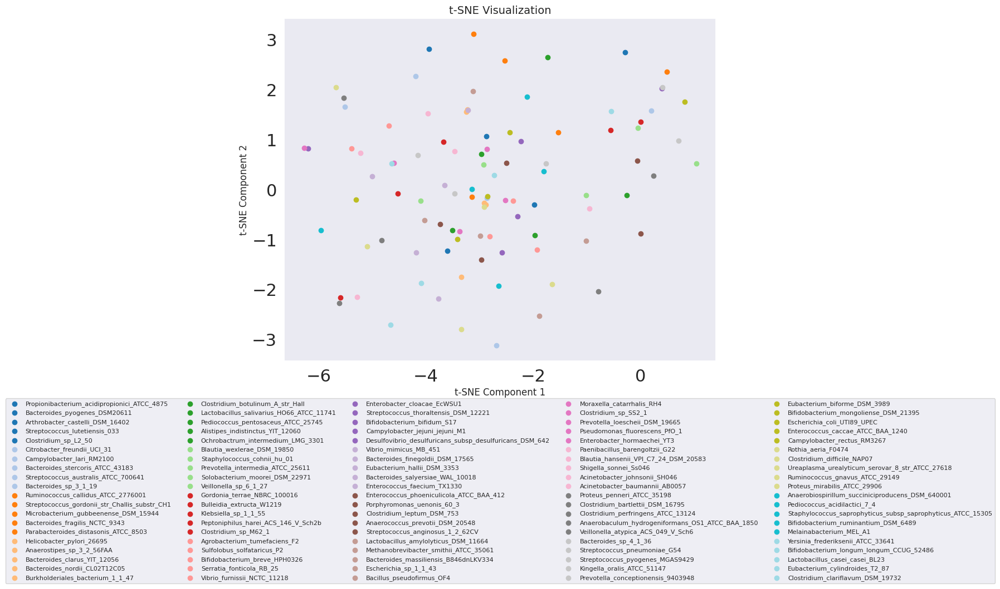

In [31]:
from sklearn.manifold import TSNE

# Initialize t-SNE
tsne = TSNE(n_components=2, random_state=42, perplexity=30, max_iter=1000)

# Fit and transform the data
X_tsne = tsne.fit_transform(scaled_data)

# Scatter plot of t-SNE results
plt.figure(figsize=(10, 8))
colormap = plt.colormaps['tab20'] # Get a color map
colors = colormap(np.linspace(0, 1, len(species)))
species_to_color = {name: colors[i] for i, name in enumerate(species)}
for i in range(X_tsne.shape[0]):
    plt.scatter(X_tsne[i , 0], X_tsne[i, 1], color=species_to_color[species[i]], label=species[i])

plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.1), ncol=5, fontsize=8)
plt.title('t-SNE Visualization', fontsize=14)
plt.xlabel('t-SNE Component 1', fontsize=12)
plt.ylabel('t-SNE Component 2', fontsize=12)
plt.grid()
plt.show()

This t-SNE plot provides a two-dimensional visualization of the dataset, where each point represents a model projected based on its similarity in exchange reactions.

1) Tightly Grouped Points: May indicate groups of organisms or models with similar exchange reaction profiles.

2) Spread-Out Points: May represent organisms with distinct or unique metabolic profiles.

3) Overlapping Points: Might suggest similarity or shared reactions between models from different clusters, potentially pointing to shared ecological niches or cross-feeding relationships.

**Determine optimal number of clusters using the elbow method and silhouette score**

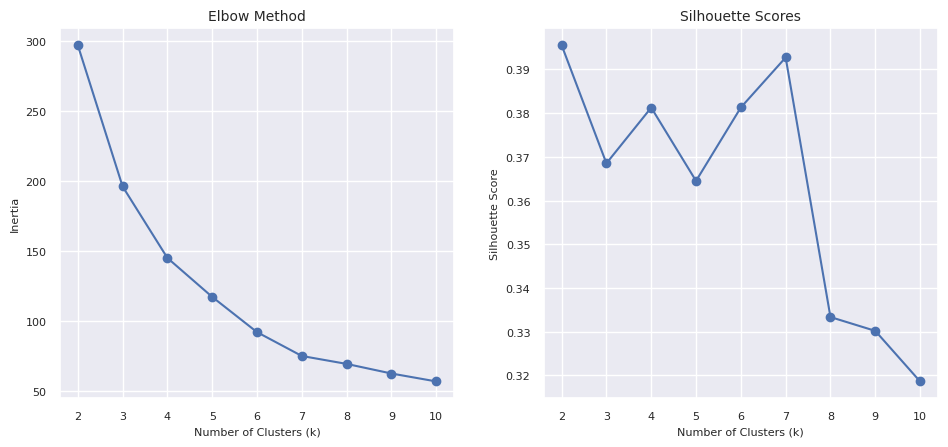

In [32]:

inertia = []  # Store the inertia (within-cluster sum of squared distances)
sil_scores = []  # Store silhouette scores

for k in range(2, 11):  # Testing k between 2 and 10
    kmeans = KMeans(n_clusters=k, random_state=0)
    kmeans.fit(X_tsne)

    # Inertia (within-cluster sum of squared distances)
    inertia.append(kmeans.inertia_)

    # Silhouette Score
    sil_score = silhouette_score(X_tsne, kmeans.labels_)
    sil_scores.append(sil_score)

# Plot the elbow method
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.plot(range(2, 11), inertia, marker='o')
plt.title('Elbow Method', fontsize = 10)
plt.xlabel('Number of Clusters (k)', fontsize=8)
plt.ylabel('Inertia', fontsize=8)
plt.tick_params(axis='both', labelsize=8)

# Plot silhouette scores
plt.subplot(1, 2, 2)
plt.plot(range(2, 11), sil_scores, marker='o')
plt.title('Silhouette Scores', fontsize=10)
plt.xlabel('Number of Clusters (k)', fontsize=8)
plt.ylabel('Silhouette Score', fontsize=8)
plt.tick_params(axis='both', labelsize=8)

plt.tight_layout()
plt.show()

From the above two plots, it can be seen that at cluster 7, an elbow appears distinctly as opposed to the previous scenario with PCA. Cluster 7 also holds a significantly high value compared to others in the Silhouette score plot.

**K-means clustering**

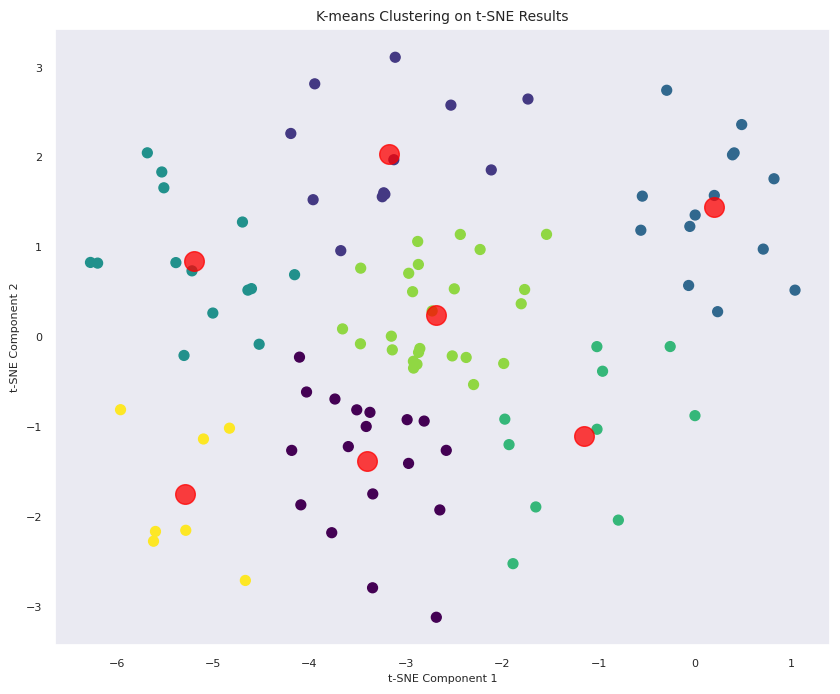

In [41]:

n_clusters = 7  # Set the number of clusters
kmeans = KMeans(n_clusters=n_clusters, random_state=0)
y_kmeanstsne = kmeans.fit_predict(X_tsne[:, :2])

# Step 2: Create the plot
plt.figure(figsize=(10, 8))
plt.scatter(X_tsne[:, 0], X_tsne[:, 1], c=y_kmeanstsne, s=50, cmap='viridis')  # Clustered points
centerstsne = kmeans.cluster_centers_
plt.scatter(centerstsne[:, 0], centerstsne[:, 1], c='red', s=200, alpha=0.75, label='Centroids')

# Step 3: Add titles and labels
plt.title('K-means Clustering on t-SNE Results', fontsize=10)
plt.xlabel('t-SNE Component 1', fontsize=8)
plt.ylabel('t-SNE Component 2', fontsize=8)
plt.tick_params(axis='both', labelsize=8)
# Set axis limits to center (0, 0)
plt.grid()
plt.show()

**Investigating the properties of each cluster**

In this step, summary statistics for each cluster will be created based on the exchange reaction fluxes of each member of the cluster.

In [34]:
df_imputed_tsne = df_imputed
numeric_columns = df_imputed.select_dtypes(include='number').columns
df_imputed_tsne['Cluster'] = y_kmeanstsne  # Add cluster labels to the DataFrame
# Calculate summary statistics for each cluster
cluster_profiles = df_imputed[numeric_columns].groupby('Cluster').agg(['mean', 'median', 'std', 'min', 'max'])
cluster_profiles

EX_12ppd_S(e)                                       EX_26dap_M(e)  \
                 mean median         std     min        max          mean   
Cluster                                                                     
0          -55.555556    0.0  235.702260 -1000.0   0.000000     -1.664727   
1            0.000000    0.0    0.000000     0.0   0.000000     -5.080710   
2            0.000000    0.0    0.000000     0.0   0.000000     -0.117881   
3          -71.428571    0.0  267.261242 -1000.0   0.000000     -2.754162   
4            7.351230    0.0   23.246630     0.0  73.512297     -0.428081   
5            0.000000    0.0    0.000000     0.0   0.000000    -66.932094   
6            0.000000    0.0    0.000000     0.0   0.000000     -0.623496   

                                               EX_4abz(e)                      \
           median         std         min  max       mean    median       std   
Cluster                                                                         
0        0.000000    2.341317   -5.962055  0.0  -0.075016  0.000000  0.218364   
1       -1.312031   12.651988  -44.932757  0.0  -0.197094  0.000000  0.460988   
2       -0.137116    0.053998   -0.168627  0.0  -0.183036  0.000000  0.684857   
3       -3.607244    1.906525   -5.137169  0.0  -0.786218 -0.638631  0.830077   
4       -0.121902    0.740399   -2.015229  0.0  -0.383186  0.000000  0.817723   
5       -0.103914  229.980171 -901.123444  0.0  -0.252249  0.000000  0.387785   
6       -0.151371    0.756184   -1.751194  0.0  -0.285185  0.000000  0.754529   

                       EX_4hbz(e)                                              \
              min  max       mean    median         std       min         max   
Cluster                                                                         
0       -0.686714  0.0   0.000000  0.000000    0.000000  0.000000    0.000000   
1       -1.241086  0.0  -0.039806  0.000000    0.137894 -0.477678    0.000000   
2       -2.562499  0.0  -0.113961  0.000000    0.290529 -0.854166    0.000000   
3       -1.908030  0.0  32.025582 -0.480105  121.201200 -0.636010  453.125669   
4       -2.184990  0.0  -0.048381  0.000000    0.152995 -0.483813    0.000000   
5       -1.016987  0.0  -0.046318  0.000000    0.115962 -0.456812    0.000000   
6       -1.996297  0.0  -0.095062  0.000000    0.251510 -0.665432    0.000000   

        EX_Lcyst(e)                           EX_ac(e)               \
               mean median  std  min  max         mean       median   
Cluster                                                               
0               0.0    0.0  0.0  0.0  0.0   943.953894  1000.000000   
1               0.0    0.0  0.0  0.0  0.0   951.092005  1000.000000   
2               0.0    0.0  0.0  0.0  0.0   981.267564  1000.000000   
3               0.0    0.0  0.0  0.0  0.0   977.098049  1000.000000   
4               0.0    0.0  0.0  0.0  0.0   694.269077   996.106309   
5               0.0    0.0  0.0  0.0  0.0   666.118228   961.474369   
6               0.0    0.0  0.0  0.0  0.0  1000.000000  1000.000000   

                                           EX_acald(e)              \
                  std          min     max        mean      median   
Cluster                                                              
0        2.352618e+02     1.323094  1000.0  -88.402828    0.000000   
1        1.694223e+02   413.104055  1000.0  265.921032    0.000000   
2        7.009036e+01   737.745891  1000.0 -660.363029 -998.519548   
3        8.569126e+01   679.372682  1000.0   83.871366    0.000000   
4        4.770707e+02     0.000000  1000.0 -393.290140    0.000000   
5        4.338175e+02   -54.396514  1000.0   79.306470    0.000000   
6        4.641246e-14  1000.000000  1000.0  142.857143    0.000000   

                                                 EX_acgam(e)         \
                std           min          max          mean median   
Cluster                                                      

In [35]:
# Create a heatmap of the mean values of exchange reactions per cluster
numeric_columns_tsne = df_imputed_tsne.select_dtypes(include='number').columns
mean_values = df_imputed_tsne[numeric_columns_tsne].groupby('Cluster').mean()
plt.figure(figsize=(200, 70))
sns.heatmap(mean_values, cmap='seismic')
plt.title('Mean Exchange Reactions by Cluster', fontsize=70)
plt.xlabel('Exchange Reactions', fontsize=50)
plt.ylabel('Cluster', fontsize=50)
plt.xticks(fontsize=30)
plt.tight_layout()
plt.show()

<p align="justify">From the heatmap, we can see that there are certain reactions a cluster can have a mean positive flux while another having a negative flux. These could be possible indications of cross-feeding relationships. To investigate this behavior, a community model of representative organisms could be simulated.</p>

## PCA vs t-SNE
Here, we will compare the two tecnhiques of dimensionality reduction in order to identify the best approach.

1) Adjusted Rand Index - quantifies the degree of agreement between two cluster assignments, considering the possibility of random clustering.
ARI values range from -1 to 1.


*   1: Perfect agreement between the two clusterings.
*   0: No better than random agreement.
*   <0: Worse than random (unlikely in well-clustered data).






In [36]:
from sklearn.metrics import adjusted_rand_score

ari_score = adjusted_rand_score(y_kmeans, y_kmeanstsne)
print("Adjusted Rand Index (ARI) between PCA and t-SNE clusters:", ari_score)

Adjusted Rand Index (ARI) between PCA and t-SNE clusters: 0.17544471148974802


An ARI score of 0.175 is closer to 0, suggesting that the clustering results from PCA and t-SNE do not align very well.

2) Silhouette Score - Measures how similar an object is to its own cluster (cohesion) compared to other clusters (separation).


*   +1: Perfect clustering, points are well-separated and compact within their clusters.
*   0: Overlapping clusters or the point is on the decision boundary.


*   -1: Poor clustering, points are closer to other clusters than their own.

3) Davies-Bouldin Score - Measures the average "similarity" ratio between each cluster and the cluster that is most similar to it. Lower is better.


*   0: Ideal clustering, clusters are well-separated and compact.
*   Higher values indicate worse clustering (less separation and more spread out clusters).








In [37]:
from sklearn.metrics import silhouette_score, davies_bouldin_score

# Silhouette and Davies-Bouldin Scores for PCA
silhouette_pca = silhouette_score(X_r, y_kmeans)
davies_bouldin_pca = davies_bouldin_score(X_r, y_kmeans)

# Silhouette and Davies-Bouldin Scores for t-SNE
silhouette_tsne = silhouette_score(X_tsne, y_kmeanstsne)
davies_bouldin_tsne = davies_bouldin_score(X_tsne, y_kmeanstsne)

print("PCA Silhouette Score:", silhouette_pca)
print("t-SNE Silhouette Score:", silhouette_tsne)
print("PCA Davies-Bouldin Score:", davies_bouldin_pca)
print("t-SNE Davies-Bouldin Score:", davies_bouldin_tsne)

PCA Silhouette Score: 0.11123069819909888
t-SNE Silhouette Score: 0.39272037
PCA Davies-Bouldin Score: 2.642567657484009
t-SNE Davies-Bouldin Score: 0.7774209824975704


**Identifying the most representative organism from each cluster**
<p align="justify">To identify the most representative organism within each cluster, an intermediate approach was applied. First, the three organisms closest to the cluster centroid were identified based on their proximity in the reduced feature space. Among these top three candidates, the organism with the highest number of non-zero exchange reactions (a proxy for metabolic activity) was selected as the most representative. This method balances spatial closeness to the centroid with functional relevance, ensuring that the chosen organism is both central to the cluster and biologically significant.</p>

In [38]:
# Count non-zero values row-wise (for each organism)
df_imputed_tsne['Non_Zero_Exchange_Count'] = (df_imputed_tsne != 0).sum(axis=1)
# Getting the organism name into a separate column
df_imputed_tsne['Organism_Name'] = df_imputed_tsne.index.map(lambda i: species[i])

unique_clusters = np.unique(y_kmeanstsne)
representative_organisms = []

for cluster in unique_clusters:
    # Get indices of organisms in the current cluster
    cluster_indices = np.where(y_kmeanstsne == cluster)[0]

    # Extract t-SNE coordinates and exchange counts for the organisms in this cluster
    cluster_points = X_tsne[cluster_indices]
    cluster_exchange_counts = df_imputed_tsne.iloc[cluster_indices]['Non_Zero_Exchange_Count'].values
    cluster_organism_names = df_imputed_tsne.iloc[cluster_indices]['Organism_Name'].values

    # Calculate the cluster centroid
    centroid = cluster_points.mean(axis=0)

    # Calculate distances of each point to the centroid
    distances_to_centroid = cdist([centroid], cluster_points)[0]

    # Find the closest points to the centroid
    closest_points_indices = np.argsort(distances_to_centroid)[:5]  # Adjust this number if needed

    # Among the closest points, select the organism with the highest exchange reactions
    best_idx = closest_points_indices[np.argmax([cluster_exchange_counts[i] for i in closest_points_indices])]
     # Create a dictionary for the representative organism's info
    representative_organisms.append({
        'Organism': cluster_organism_names[best_idx],
        'Cluster': cluster,
        'Distance_to_Centroid': distances_to_centroid[best_idx],
        'Non_Zero_Exchange_Count': cluster_exchange_counts[best_idx]
    })

# Convert the list of dictionaries to a DataFrame
representative_organisms_df = pd.DataFrame(representative_organisms)

# Display the DataFrame
representative_organisms_df

,Organism,Cluster,Distance_to_Centroid,Non_Zero_Exchange_Count
0,Streptococcus_anginosus_1_2_62CV,0,0.427600,52
1,Bacteroides_fragilis_NCTC_9343,1,0.837268,75
2,Streptococcus_thoraltensis_DSM_12221,2,0.613717,85
3,Shigella_sonnei_Ss046,3,0.107998,79
4,Sulfolobus_solfataricus_P2,4,0.785889,76
5,Porphyromonas_uenonis_60_3,5,0.343449,71
6,Clostridium_bartlettii_DSM_16795,6,0.614538,66


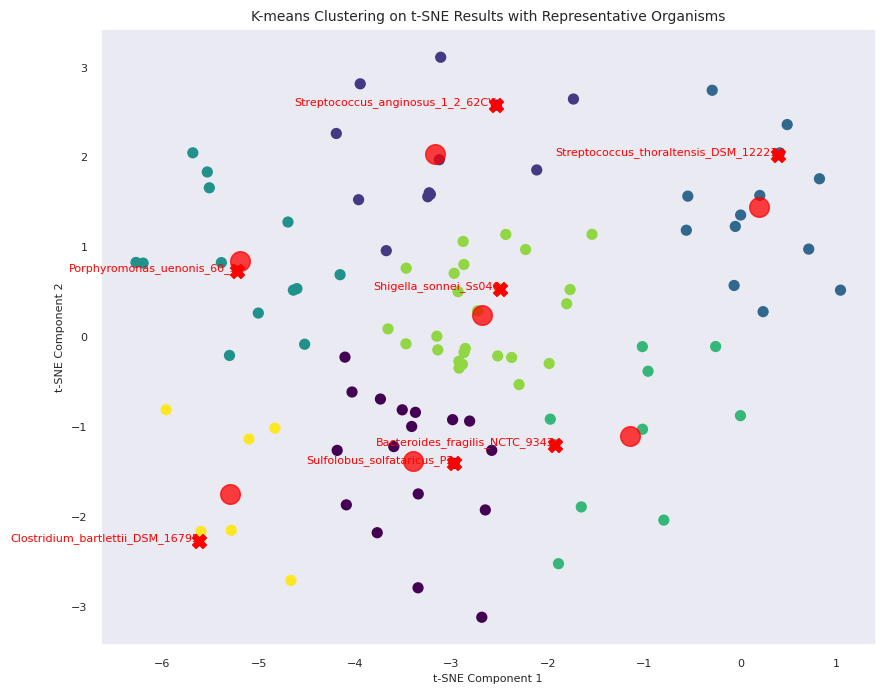

In [39]:
# Graphically displaying the representative organisms
# Performing K-means clustering
n_clusters = 7  # Set the number of clusters
kmeans = KMeans(n_clusters=n_clusters, random_state=0)
y_kmeanstsne = kmeans.fit_predict(X_tsne[:, :2])

# Step 2: Create the plot
plt.figure(figsize=(10, 8))
plt.scatter(X_tsne[:, 0], X_tsne[:, 1], c=y_kmeanstsne, s=50, cmap='viridis')  # Clustered points
centerstsne = kmeans.cluster_centers_
plt.scatter(centerstsne[:, 0], centerstsne[:, 1], c='red', s=200, alpha=0.75, label='Centroids')

# Highlight the top members
representative_organisms_names = representative_organisms_df['Organism']

# Extract tsne coordinates for top members from X_tsne using the index of top members
representative_organisms_indices = df_imputed_tsne[df_imputed_tsne['Organism_Name'].isin(representative_organisms_names)].index
representative_organisms_tsne = X_tsne[representative_organisms_indices, :2]

for i, name in enumerate(representative_organisms_names):
    plt.scatter(representative_organisms_tsne[i, 0], representative_organisms_tsne[i, 1], color='red', s=100, marker='X', label='Representative Organism')
    # Add text for each top member
    plt.text(representative_organisms_tsne[i, 0], representative_organisms_tsne[i, 1], name, fontsize=8, ha='right', color='red')

# Step 3: Add titles and labels
plt.title('K-means Clustering on t-SNE Results with Representative Organisms', fontsize=10)
plt.xlabel('t-SNE Component 1', fontsize=8)
plt.ylabel('t-SNE Component 2', fontsize=8)
plt.tick_params(axis='both', labelsize=8)
# Set axis limits to center (0, 0)
plt.grid()
plt.show()

In [40]:
# Convert the list to a DataFrame for easier saving to CSV
df_savedRepOrganisms = pd.DataFrame(representative_organisms_df, columns=["Organism"])
df_savedRepOrganisms.to_csv("/content/drive/My Drive/AGORA/CurrentVersion/AGORA_1_03/AGORA_1_03_sbml/representative_organisms.csv", index=False)  # Save as CSV file